In [5]:
import sys
import time
import csv
import math
import numpy as np
from pyspark import SparkContext
import json
from operator import add
import pandas as pd
import xgboost as xgb
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
from node2vec import Node2Vec as n2v
import networkx as nx
from hashlib import md5
import pickle
import os

def PartHash(string):
    seed = 131
    hash = 0
    for ch in string:
        hash = hash * seed + ord(ch)
    return hash & 0x7FFFFFFF


# folder_path = "datasets/"
# test_filepath = "datasets/yelp_val.csv"
# output_filepath = "../output_task2_2.csv"
folder_path = "../data/"
test_filepath = "../yelp_true.csv"
output_filepath = ""

In [2]:
sc = SparkContext('local[*]', 'graphembedding').getOrCreate()
sc.setLogLevel("ERROR")

24/04/16 13:21:13 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
Using Spark's default log4j profile: org/apache/spark/log4j-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
24/04/16 13:21:14 WARN Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.


## Copying Original Graph Embeddiing (Graph Generation) Here, Commented, rerun if necessary

In [8]:
# start_time = time.time()

# # prepare datasets
# yelp_train = folder_path + "yelp_train.csv"
# ############## only uncomment if train on local (yelp_test is a random dataset created on business_train)
# # yelp_test = folder_path + "yelp_test.csv"
# user = folder_path + "user.json"
# business = folder_path + "business.json"

# start_time = time.time()
# # '''
# # read the dataset
# # train_dataset (uid_bid_stars)
# rdd1 = sc.textFile(yelp_train)
# head = rdd1.first()
# train_rdd = rdd1.filter(lambda x: x != head).map(lambda x: x.split(",")).map(lambda x: (x[0], x[1], float(x[2])))
# # val_dataset
# rdd2 = sc.textFile(test_filepath)
# head2 = rdd2.first()
# val_rdd = rdd2.filter(lambda x: x != head2).map(lambda x: x.split(",")).map(lambda x: (x[0], x[1]))

# # business_dataset
# business_rdd = sc.textFile(business).map(lambda line: json.loads(line)).map(lambda x: (x['business_id'], x["categories"]))
# # user_dataset
# user_rdd = sc.textFile(user).map(lambda line: json.loads(line)).map(lambda x: (x["user_id"], x["friends"]))

# # for all the ids we currently have
# # business_ids
# business_list = list(set(train_rdd.map(lambda x: x[1]+"_bid").collect() + val_rdd.map(lambda x: x[1]+"_bid").collect()))
# ################### only uncomment if train on local.
# # business_list = list(set(train_rdd.map(lambda x: x[1] + "_bid").collect() + val_rdd.map(lambda x: x[1] + "_bid").collect() + test_rdd.map(lambda x: x[1] + "_bid").collect()))
# # user_ids
# user_list = list(set(train_rdd.map(lambda x: x[0] + "_uid").collect() + val_rdd.map(lambda x: x[0] + "_uid").collect()))

# ################### only uncomment if train on local.
# # user_list = list(set(train_rdd.map(lambda x: x[0]+"_uid").collect() + val_rdd.map(lambda x: x[0] + "_uid").collect() + test_rdd.map(lambda x: x[1] + "_uid").collect()))

# # deal with business and user dataset
# remaining_business = business_rdd.partitionBy(10, PartHash) \
#     .map(lambda x: (x[0]+"_bid",x[1])) \
#     .filter(lambda x: x[0] in business_list) \
#     .map(lambda x: (x[0], x[1].replace("&"," ").replace("/"," ").replace("(","").replace(")","").replace("  ","").split(",") if x[1] is not None else ""))\
#     .map(lambda x: (x[0], [h.strip().lower() for h in x[1]]))

# remaining_user = user_rdd.partitionBy(10, PartHash) \
#     .map(lambda x: (x[0] + "_uid", [single.strip()+"_uid" for single in x[1].split(",")])) \
#     .filter(lambda x: x[0] in user_list) \
#     .map(lambda x: (x[0], [i for i in x[1] if i in user_list]))

# print("BEFORE JOIN PAIRS HAVE FINISHED!")
# print("Duration: ", time.time() - start_time)

In [10]:
# start_time = time.time()

# # build business pairs and friend pairs
# remaining_business_list = remaining_business.collect()
# business_label_pair = set()
# for single_ele in remaining_business_list:
#     b_id = single_ele[0]
#     corr_labels = single_ele[1]
#     if corr_labels != []:
#         for label  in corr_labels:
#             if label != "":
#                 business_label_pair.add(tuple(sorted([b_id, md5(label.encode(encoding='UTF-8')).hexdigest()])))

# remaining_user_list = remaining_user.collect()
# user_friend_pair = set()
# for single_ele in remaining_user_list:
#     u_id = single_ele[0]
#     u_friends = single_ele[1]
#     if u_friends != []:
#         for friend in u_friends:
#             if friend != "" and friend != "_uid":
#                 user_friend_pair.add(tuple(sorted([u_id, friend])))
# new_final_list = list(business_label_pair) + list(user_friend_pair)

# # for all original pairs
# train_pair = train_rdd.map(lambda x: (x[0],x[1])).collect()
# val_pair = val_rdd.collect()
# ################### only uncomment if train on local.
# # test_pair = test_rdd.collect()
# # final_list = train_pair+val_pair+test_pair
# final_list = train_pair + val_pair
# print("FINISH BUILDING THE PAIRS.")
# print("Duration: ", time.time() - start_time)

FINISH BUILDING THE PAIRS.
Duration:  55.011449575424194


In [11]:
# # generating relationship
# with open('GraphEdgeInfo.txt', 'w+') as f:
#     for pair_original in final_list:
#         f.write(f'{pair_original[0]+"_uid"} {pair_original[1]+ "_bid"}\n')
#     for pair_new in new_final_list:
#         f.write(f'{pair_new[0]} {pair_new[1]}\n')
# print("FINISH WRITING THE PAIRS.", "TIME:", time.time()-start_time)

FINISH WRITING THE PAIRS. TIME: 109.12937021255493


## 使用图数据（如业务-业务、业务-用户和业务-类别关系）来构建图,进行图分析

In [19]:
import networkx as nx

# 加载图
graph = nx.read_edgelist('GraphEdgeInfo.txt', create_using=nx.DiGraph(), nodetype=str, data=[('weight', int)])

# 可能的预处理步骤
# 移除自循环
graph.remove_edges_from(nx.selfloop_edges(graph))

# 查看图的基本信息
print(nx.info(graph))

DiGraph with 37225 nodes and 888543 edges


/tmp/ipykernel_6291/2019220436.py:11: DeprecationWarning: info is deprecated and will be removed in version 3.0.

  print(nx.info(graph))


In [20]:
G = graph
print(nx.info(G))   # 查看图的基本信息
# print('nx.degree:',nx.degree(G))  # 返回图中各顶点的度
print('nx.density:',nx.degree_histogram(G))  # 返回图中度的分布

DiGraph with 37225 nodes and 888543 edges
nx.density: [0, 139, 83, 157, 332, 536, 666, 851, 933, 1041, 1064, 1065, 1062, 1011, 974, 928, 882, 853, 788, 754, 674, 653, 563, 505, 572, 654, 665, 571, 616, 593, 590, 575, 525, 473, 473, 474, 438, 416, 381, 372, 319, 353, 311, 309, 280, 264, 259, 273, 237, 232, 239, 232, 236, 223, 186, 212, 170, 176, 184, 161, 179, 155, 154, 134, 156, 150, 124, 140, 134, 124, 133, 126, 108, 107, 114, 94, 106, 93, 103, 103, 94, 103, 88, 80, 96, 74, 71, 74, 61, 69, 64, 64, 64, 69, 70, 67, 64, 54, 66, 58, 51, 41, 49, 41, 50, 45, 53, 50, 46, 40, 50, 43, 52, 41, 46, 19, 43, 34, 37, 23, 37, 34, 28, 34, 33, 29, 26, 41, 23, 31, 31, 18, 42, 28, 34, 29, 30, 26, 17, 29, 27, 20, 18, 25, 25, 19, 16, 29, 19, 17, 18, 25, 17, 15, 22, 24, 16, 17, 24, 17, 15, 24, 14, 12, 17, 14, 18, 14, 9, 13, 18, 11, 17, 17, 14, 14, 12, 9, 9, 15, 15, 16, 15, 7, 16, 5, 19, 13, 14, 12, 15, 13, 7, 7, 3, 16, 8, 5, 6, 8, 10, 10, 5, 11, 10, 8, 10, 8, 8, 14, 9, 7, 13, 6, 11, 8, 5, 8, 2, 9, 12, 9, 1

/tmp/ipykernel_6291/2379777515.py:2: DeprecationWarning: info is deprecated and will be removed in version 3.0.

  print(nx.info(G))   # 查看图的基本信息


In [19]:
print('nx.pagerank:',nx.pagerank(G))  # 返回图中各顶点的频率分布

nx.pagerank: {'vxR_YV0atFxIxfOnF9uHjQ_uid': 4.19891543510916e-05, 'gTw6PENNGl68ZPUpYWP50A_bid': 7.862944013853992e-05, 'o0p-iTC5yTBV5Yab_7es4g_uid': 1.3449941499966574e-05, 'iAuOpYDfOTuzQ6OPpEiGwA_bid': 6.620575390812631e-05, '-qj9ouN0bzMXz1vfEslG-A_uid': 1.2570678031120063e-05, '5j7BnXXvlS69uLVHrY9Upw_bid': 1.6047468185360554e-05, 'E43QxgV87Ij6KxMCHcijKw_uid': 3.5009166536162054e-05, 'jUYp798M93Mpcjys_TTgsQ_bid': 2.825820640486664e-05, 'T13IBpJITI32a1k41rc-tg_uid': 1.4670488211589882e-05, '3MntE_HWbNNoyiLGxywjYA_bid': 1.4270493051077455e-05, 'Q1IENmNc6bdDruACmhy4mg_uid': 1.384572172845752e-05, 'sPd3E7lFzd_yooiq-ekxtQ_bid': 1.9833397037506535e-05, '4bQqil4770ey8GfhBgEGuw_uid': 1.2778111870016951e-05, 'YXohNvMTCmGhFMSQsDZq1g_bid': 5.335417039751197e-05, '0BBUmH7Krcax1RZgbH4fSA_uid': 1.265637572265645e-05, 'XO2hZb0xC8jTexSHG4SxFg_bid': 2.6681755705867794e-05, 'QZ_Arlwoj0ghfBvg69rjOw_uid': 1.3068978343798448e-05, 'SUktrYdNQD8k2vvkM4OpfA_bid': 1.5247614077417715e-05, 'lEw2VL9JCDFk3R5Nzahqn

In [21]:
listSCC = [len(c) for c in sorted(nx.strongly_connected_components(G), key=len, reverse=True)]
maxSCC = max(nx.strongly_connected_components(G), key=len)
print('Strongly connected components:', listSCC)


# Strong connection
listWCC = [len(c) for c in sorted(nx.weakly_connected_components(G), key=len, reverse=True)]
maxWCC = max(nx.weakly_connected_components(G), key=len)
print('Weakly connected components:', listWCC)

Strongly connected components: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [23]:
# nx.draw_networkx(G)
# plt.show()

## 对于图分析的初步结论 
这个图是反映Yelp数据集中，用户-商家-分类之间的图特征的，使用了图数据（如业务-业务、业务-用户和业务-类别关系）来构建图。

- 强连通分量的分布：
您的有向图中的强连通分量全部只包含一个节点，这意味着在图中没有任何节点对（除了自环外）是双向可达的。这通常表明图中的方向性非常强，每个节点都是独立的，没有通过双向路径与其他节点相连。
这种情况可能在网络流分析或者某些类型的社交网络图中出现，其中“孤岛”节点可能代表了外围用户或者边缘服务节点。

- 弱连通分量的分布：
相反的，当考虑为无向图时，整个图只有一个连通分量，包含了所有37225个节点。这表明虽然节点间不是双向连通的，但通过忽视方向的方式，任何一个节点都可以通过一系列的边到达任何其他节点。
这说明在忽略方向的情况下，网络具有很高的连通性，适合进行如网络覆盖或者路径分析等类型的问题解决。

这个图表现了Yelp数据集中的复杂关系网络，包括用户、商家和类别之间的多种连接。从您提供的信息中，我们可以提炼出以下几点重要的结论和分析视角：

- 图的基本特征
节点和边的数量：这个有向图包含37,225个节点和888,543条边，显示了一个高度复杂的网络结构。
密度：密度（Density）是网络中实际边数与可能边数的比率。在这种情况下，网络的密度非常低，意味着大多数商家和用户之间没有直接联系，这在大规模社交或交易网络中是常见的。
- 连通分量分析
强连通分量：所有节点均为独立的强连通分量（只有一个节点），说明在用户、商家和类别间的双向直接联系极其罕见。
弱连通分量：整个图为一个单一的弱连通分量，表明尽管联系可能是单向的，任何两个节点间都存在至少一条路径（忽略方向），这对于进行市场覆盖分析和信息扩散研究非常有利。


- 市场覆盖策略：
弱连通性的高度说明了尽管用户和商家之间的互动可能不是双向的，但从整体上看，市场上的任何一方都能够在理论上接触到其他所有方。这为Yelp的市场推广活动提供了基础，即通过适当的中介（可能是具有高度中心性的商家或用户类别），可以实现广泛的市场覆盖。
- 信息传播分析：
鉴于图中存在大量的节点，但每个节点都是自己的强连通分量，可以推测信息传播主要是单向的。对于Yelp来说，这可能意味着用户的评价或者商家的回应不一定能够影响到大量的其他用户或商家，除非通过特定的路径。
- 推荐系统优化：
利用这一结构，可以优化推荐算法以便更好地连接这些单向路径，例如通过强化那些作为信息传播“桥梁”的节点的权重，从而在用户和商家之间创建更有效的推荐链。

## 改进方向：

可以进行以下几种分析和处理步骤：

**1. 特征工程**
>
a. 节点级特征
- 度中心性（Degree Centrality）：计算每个节点的入度和出度，这可以帮助理解哪些商家或用户在图中更活跃。
- PageRank：这是衡量节点影响力的一个非常有用的指标，特别是在有向图中，可以帮助捕捉到哪些商家或用户在网络中具有较高的“权威性”。
- 聚类系数（Clustering Coefficient）：尽管每个节点都是自己的强连通分量，分析局部群集可能揭示隐藏的群体结构，这对推荐系统可能有用。
> 
b. 路径级特征
- 最短路径：计算节点对之间的最短路径长度（忽略方向），这可能有助于预测用户和商家之间的互动程度。
- 结构洞（Structural Holes）：分析哪些节点在连接不同用户或商家群体中扮演桥梁角色，这些节点可以作为推荐系统中的关键“推荐点”。

**2. 社区检测**
使用社区检测算法（如 Louvain 方法）来识别图中的社区结构。社区可以定义为用户群或商家群，具有相似属性的节点更可能属于同一社区。将用户和商家的社区标签作为特征输入到推荐模型中，可能提高模型的准确度。

**3. 图嵌入**
Node2Vec、GraphSAGE 或 GNNs（图神经网络）等图嵌入方法可以用来生成可以表示原始图结构的密集向量。这些向量可以作为机器学习模型中的特征使用，有助于模型捕捉节点间复杂的关系和属性。

**4. 链接预测**
在推荐系统中，链接预测可以用来预测还未发生的用户与商家之间的互动。这可以通过分析现有的连接（例如，现有的评分）并预测未来可能的连接来实现。


5. 模型集成
考虑使用**集成学习方法将基于图的特征和传统的CF（协同过滤）** 或CB（内容基）推荐系统模型输出结合起来，以优化总体预测精度。

### 1. 进一步对图节点级特征分析

In [ ]:
# nx.degree_histogram(G)
# nx.pagerank(G)

In [24]:
def calculate_centrality(G):
    """ 计算简化图的中心性 """
    degree_centrality = nx.degree_centrality(G)
    pagerank = nx.pagerank(G) # max_iter=100
    return degree_centrality, pagerank

In [25]:
degree_centrality, pagerank = calculate_centrality(G)

In [30]:
degree_centrality

{'vxR_YV0atFxIxfOnF9uHjQ_uid': 0.011202450032237266,
 'gTw6PENNGl68ZPUpYWP50A_bid': 0.0073877068557919616,
 'o0p-iTC5yTBV5Yab_7es4g_uid': 0.0008865248226950354,
 'iAuOpYDfOTuzQ6OPpEiGwA_bid': 0.0021760154738878143,
 '-qj9ouN0bzMXz1vfEslG-A_uid': 0.002256608639587363,
 '5j7BnXXvlS69uLVHrY9Upw_bid': 0.0005641521598968407,
 'E43QxgV87Ij6KxMCHcijKw_uid': 0.022539222007307114,
 'jUYp798M93Mpcjys_TTgsQ_bid': 0.0005372877713303245,
 'T13IBpJITI32a1k41rc-tg_uid': 0.004513217279174726,
 '3MntE_HWbNNoyiLGxywjYA_bid': 0.0002955082742316785,
 'Q1IENmNc6bdDruACmhy4mg_uid': 0.001907371588222652,
 'sPd3E7lFzd_yooiq-ekxtQ_bid': 0.000725338491295938,
 '4bQqil4770ey8GfhBgEGuw_uid': 0.0010208467655276165,
 'YXohNvMTCmGhFMSQsDZq1g_bid': 0.005614657210401891,
 '0BBUmH7Krcax1RZgbH4fSA_uid': 0.012787448957661722,
 'XO2hZb0xC8jTexSHG4SxFg_bid': 0.0019342359767891683,
 'QZ_Arlwoj0ghfBvg69rjOw_uid': 0.0015849989254244573,
 'SUktrYdNQD8k2vvkM4OpfA_bid': 0.0002955082742316785,
 'lEw2VL9JCDFk3R5NzahqnA_uid': 0.007

In [26]:
# 输出中心性和PageRank的高值节点
high_centrality_nodes = {node: cent for node, cent in degree_centrality.items() if cent > 0.01}
high_pagerank_nodes = {node: pr for node, pr in pagerank.items() if pr > 0.005}

In [33]:
high_centrality_nodes

{'vxR_YV0atFxIxfOnF9uHjQ_uid': 0.011202450032237266,
 'E43QxgV87Ij6KxMCHcijKw_uid': 0.022539222007307114,
 '0BBUmH7Krcax1RZgbH4fSA_uid': 0.012787448957661722,
 'Fv0e9RIV9jw5TX3ctA1WbA_uid': 0.02441972920696325,
 'pMefTWo6gMdx8WhYSA2u3w_uid': 0.014345583494519663,
 'UPIYuRaZvknINOd1w8kqRQ_bid': 0.012760584569095207,
 'UYcmGbelzRa0Q6JqzLoguw_uid': 0.04677090049430475,
 'PKEzKWv_FktMm2mGPjwd0Q_uid': 0.0417203954437997,
 '8AwcaBJjiMpQ__FPxktwwQ_uid': 0.014345583494519663,
 '_VMGbmIeK71rQGwOBWt_Kg_uid': 0.01864388566516226,
 'hTZb1INhnCG8URaFywVoYQ_uid': 0.017461852568235545,
 'N3oNEwh0qgPqPP3Em6wJXw_uid': 0.022619815173006663,
 'm-BZLIIh5PCAKnzH0qj_0Q_uid': 0.014291854717386632,
 'wXZS42D0L8hoCiSh2Krc_A_uid': 0.012035246077799268,
 'cYwJA2A6I12KNkm2rtXd5g_bid': 0.010315925209542231,
 'd5WLqmTMvmL7-RmUDVKqqQ_uid': 0.011121856866537718,
 'JnPIjvC0cmooNDfsa9BmXg_uid': 0.012572533849129593,
 '7Oe6ikklTjVBbEFw9emLcA_uid': 0.017891682785299807,
 'SlgpAnj2gQd44EM_Uq6DkQ_uid': 0.012868042123361272

In [34]:
high_pagerank_nodes

{'b7f8f342d75c02699b7873f497f4251c': 0.005967296511581442,
 '49cfbe257fc2454107e5b4daf9f83e13': 0.006543823504426392,
 'eef4e33361d1377ab483a3c44cd2dd59': 0.012625949576835662,
 'b3c57d227ea117c0ace12e4538754344': 0.00686299137363107,
 'f2f7141df8592be8740172efb2766054': 0.007714810303538066,
 'babd2925f9a5fe57586bd10374bdecc6': 0.009154904743688892,
 'b2fe440cb7a0b127f1a90ffea296313b': 0.00755275710593123,
 'dfaf4824df9669d973b868f9be7909ff': 0.005266227236035293,
 'b4cdc4d89cbc7c0d18530c968674f7c6': 0.013327093317650335,
 'f57611add43f15fbaa6bd04331da3019': 0.006980318924727074}

In [36]:
mid_pagerank_nodes = {node: pr for node, pr in pagerank.items() if ((pr < 0.005) & (pr > 0.001))}
mid_pagerank_nodes

{'694ba3902596c149c44543e5b48b4d8c': 0.0019564161066284533,
 'eee6b2aa1bf67d7074c06b49c257cdbb': 0.003523998173633234,
 'ef9f6b385666e3fe4a6f60477a0c7989': 0.0034023724373311226,
 'd7eba311421bbc9d3ada44709dd61534': 0.0014654540188310803,
 '62506be34d574da4a0d158a67253ea99': 0.0029075577230136323,
 'a9190f6cd07b85859643e4323600b538': 0.0018749917935905953,
 'c2e055acd7ea39b9762acfa672a74136': 0.004172611113289216,
 'cfeffc2540fda42e7cd58bf6a20e9c44': 0.0035497477490409987,
 '994fac5e1016aa7b4f2ac02149f04ff8': 0.0012051307707979099,
 '7cf2db5ec261a0fa27a502d3196a6f60': 0.00116284916943329,
 'a029c3d3081ad4a884c310f3e46d6a09': 0.0031658045911521393,
 'c2494875353d814244bb87848b200711': 0.004007049221009437,
 '8175469f5b7510febe85d18daa424a3f': 0.001148766174988198,
 'f88008dc63a67983e5824dafa0935662': 0.0013747108650394167,
 'dac285f954ce212a9505eb657ca09e59': 0.004446545779114275,
 'a4c1d45db3ece0616e0a380600d3cb35': 0.0027374952981682153,
 'e021a4522f2a255e75d772b80eaea158': 0.00170432

### 解读高中心性和高PageRank节点
- 高度中心性节点（Degree Centrality）

高中心性节点通常表示在图中具有大量直接联系的节点。在Yelp的上下文中，这可能意味着某些用户或商家与许多其他用户或商家有直接的互动关系，这使得他们在网络中处于中心位置。
例如，用户UYcmGbelzRa0Q6JqzLoguw_uid和商家Fv0e9RIV9jw5TX3ctA1WbA_uid的高度中心性可能指示他们是活跃用户或热门商家，分别吸引了大量的用户互动或提供了广泛的服务。
- 高PageRank节点

PageRank衡量的是节点的影响力，不仅考虑了连接数（如度中心性），还考虑了连接质量（连接节点的重要性）。高PageRank的节点可能是影响力较大的用户/商家/类别，他们的评价或服务可能对其他用户的决策有较大影响，或者这个类别的重要性更高。
在您的数据中，**高PageRank的节点主要是商家类别**（如49cfbe257fc2454107e5b4daf9f83e13），这可能表明某些特定类型的商家在用户决策中扮演着关键角色，例如可能代表了餐厅、酒店等高影响力的业务类别。


#### 进一步分析和处理建议
- 社交影响力分析：(暂时不考虑，怕overpredict）

> *深入分析这些高中心性和高PageRank节点的社交行为模式，比如他们常去的商家类型、他们的评价倾向性等。
使用这些信息来优化推荐算法，比如更倾向于推荐那些被高影响力用户好评的商家。*

- 分类特征分析：

> 对于高PageRank的商家类别，进一步分析这些类别的具体特征，如哪些具体服务或商品是用户评价中提到的焦点。
这些分析可以帮助您理解为什么这些分类在用户决策中如此重要，并可能用于调整商家的市场策略。

- 连接模式和路径分析：

>探索高中心性或高PageRank节点之间的连接模式，比如它们是否倾向于形成特定的群组或社区。
使用图算法如最短路径计算或网络流分析来查看信息、影响力如何在网络中流动。

- 影响力模型建立：

>建立模型来预测基于影响力节点的评分模式，这可以作为推荐系统的一个强有力的特征。
分析用户如何受到这些中心节点的影响，比如通过模拟传播过程来预测一个用户可能的评分行为。

#### TODO：test社区算法来生成用户和商家的社区标签

In [13]:
# !pip install community
# !pip install python-louvain

In [17]:
import community.community_louvain as community_louvain

G_undirected = G.to_undirected()

In [23]:
# took too long

# G_undirected = G.to_undirected()
# partition = community_louvain.best_partition(G_undirected)
# # 可视化（可选）

# pos = nx.spring_layout(G_undirected)
# cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
# nx.draw_networkx_nodes(G_undirected, pos, partition.keys(), node_size=40, 
#                        cmap=cmap, node_color=list(partition.values()))
# nx.draw_networkx_edges(G_undirected, pos, alpha=0.5)
# plt.show()

## TODO:探索高中心性或高PageRank节点之间的连接模式，特别是检查它们是否倾向于形成特定的群组或社区

In [27]:
high_value_nodes = set(high_centrality_nodes.keys()).union(high_pagerank_nodes.keys())
subgraph = G.subgraph(high_value_nodes)

In [31]:
from networkx.algorithms.community import greedy_modularity_communities

communities = list(greedy_modularity_communities(subgraph))

# 输出社区信息
for i, community in enumerate(communities):
    print(f"Community {i+1}: {community}")

Community 1: frozenset({'yZpzRSK00hFeLNnwOf8R1g_uid', 'RESDUcs7fIiihp38-d6_6g_bid', 'lsZlV02ZdqEzR-qILdT7Cw_uid', 'D43OWyfzIQjL8feJpYh2SQ_uid', 'BI4jBJVto2tEQ0NiaR0rNQ_uid', 'eZfHm0qI8A_HfvXScwIYsg_uid', '9KCoXFS7alSJsGfFsZANFQ_uid', 'k4M43lXJuQMpQW65DTqzIQ_uid', 'uEvusDwoSymbJJ0auR3muQ_uid', 'ef9f6b385666e3fe4a6f60477a0c7989', '3dac72783f355eb5f7204a16e28581aa', 'Ae4uXwFHp-5fGrt6OONaXw_uid', 'gDy6k3AqlkcN4cEIkWnx_A_uid', 'A1yK1QyPaahfwp38zqn2Bg_uid', 'dfaf4824df9669d973b868f9be7909ff', 'b4cdc4d89cbc7c0d18530c968674f7c6', 'c2494875353d814244bb87848b200711', 'uG35h72BAMutvXAWdRpqCQ_uid', 'lQGJcwX105k17081f6pulg_uid', 'lT49-Xggq_VAB2E9dce0yA_uid', '24902e939ce885f611f60eefb6c7ed68', 'qewG3X2O4X6JKskxyyqFwQ_uid', '3nIuSCZk5f_2WWYMLN7h3w_uid', '3Vd_ATdvvuVVgn_YCpz8fw_uid', 'JyxHvtj-syke7m9rbza7mA_bid', 'Q7IoE5m2heQKThuVq3SYFA_uid', 'bLbSNkLggFnqwNNzzq-Ijw_uid', 'XXW_OFaYQkkGOGniujZFHg_bid', 'quDu_Z0-i9TCYvdHRnULEw_uid', 'Nhk0jTP2gkU12G4LHJVR3A_uid', 'g8OnV26ywJlZpezdBnOWUQ_bid', '3e1867f5a

In [35]:
import matplotlib.pyplot as plt

# 可视化网络和社区
pos = nx.spring_layout(subgraph)  # 使用Spring布局
plt.figure(figsize=(128, 128))
for community in communities:
    nx.draw_networkx_nodes(subgraph, pos, nodelist=community, node_size=70)
nx.draw_networkx_edges(subgraph, pos, alpha=0.5)
nx.draw_networkx_labels(subgraph, pos, font_size=9)
plt.title('Subgraph Visualization')
plt.show()

In [33]:
# 计算社区内和社区间的边密度
intra_edges = inter_edges = 0
for u, v in subgraph.edges():
    if any(u in community and v in community for community in communities):
        intra_edges += 1
    else:
        inter_edges += 1

print(f"Intra-community edges: {intra_edges}")
print(f"Inter-community edges: {inter_edges}")

Intra-community edges: 9042
Inter-community edges: 1957


#### 社区检测结果理解
社区检测显示了多个社区，每个社区由一组节点构成，如下所示：

- 社区 1
包含了大量的用户和商家节点，这表明这些节点在社交或业务活动中可能存在较高的交互频率和群体行为。例如，这些可能是在特定地区或特定业务领域内频繁互动的用户群和商家群。

- 社区 2
也包含一些用户和商家，尽管没有社区 1 那么多，但也表示了另一种可能的互动模式或者社交圈。

- 社区 3-31
这些社区大多只包含一个或少数几个节点，可能表明这些节点在图中相对孤立，与其他节点的联系较少，或者它们代表了非常独特的业务类型或用户兴趣，与主流或大众的兴趣和活动有所不同。

- 连接模式分析
  
>Intra-community edges (社区内部边): 9042
这一数量较高的社区内部边显示了社区内部节点之间存在强烈的联系和交互。这是社区形成的主要驱动力，表明社区内的节点在某些属性（如地理位置、兴趣、消费习惯等）上可能具有高度的相似性。

>Inter-community edges (社区间边): 1957
较低的社区间边数量可能表明不同社区之间的交互较少，各个社区可能在某些关键特征上有显著的区别，如可能在不同的地理区域，或者关注不同类型的业务。

- 推荐系统优化
利用社区内部的强联系和相似性，推荐系统可以优先推荐用户在其所在社区内高评价的商家，可能会提高用户的满意度和参与度。
> 新业务机会探索
对于那些社区成员较少的社区，Yelp可能需要进一步分析这些社区的特定需求或偏好，从而探索新的业务机会或提供个性化服务。

# Helper: 全映射表final_dict (Completed, ps：也可以用rdd如果后续需要效率提升)

## 建设映射表帮助理解category, city_encoded代表的是哪些

In [4]:
from better_features import FeatureProcessor, read_json_data, transform_user_data, transform_business_data,extract_review_data,extract_business_data

folder_path = '../data/'
user_df = pd.read_csv('../well-trained/cache/user_df.csv')
business_df = pd.read_csv('../well-trained/cache/business_df.csv')
review_data = read_json_data(folder_path + '/review_train.json', extract_review_data, sc).collect()

feature_processor = FeatureProcessor(user_df, business_df, review_data)

In [5]:
def create_category_md5_mapping(df):
    """
    This function creates a mapping table for business's category strings to their corresponding MD5 hash.

    Args:
    df (pd.DataFrame): DataFrame containing a column 'categories' with category strings.

    Returns:
    pd.DataFrame: A DataFrame with original business's category strings and their corresponding MD5 hashes.
    """
    # Ensure the input column is exploded to have one category per row
    exploded_df = df.explode('categories').dropna(subset=['categories']).drop_duplicates(subset=['categories'])

    # Calculate MD5 hash for each category
    exploded_df['category_md5'] = exploded_df['categories'].apply(lambda x: md5(x.encode('UTF-8')).hexdigest())

    # Create a DataFrame to store the mapping from category to MD5
    mapping_df = exploded_df[['categories', 'category_md5']].drop_duplicates()
    return mapping_df

# a map between md5 and category string
category_md5_df = create_category_md5_mapping(feature_processor.business_df)
print(category_md5_df)

                                               categories  \
0       Tours, Breweries, Pizza, Restaurants, Food, Ho...   
1       Chicken Wings, Burgers, Caterers, Street Vendo...   
2       Breakfast & Brunch, Restaurants, French, Sandw...   
3                           Insurance, Financial Services   
4       Home & Garden, Nurseries & Gardening, Shopping...   
...                                                   ...   
188586  Restaurants, Indian, Caterers, Event Planning ...   
188587          Auto Repair, Used Car Dealers, Automotive   
188589  Fashion, Women's Clothing, Accessories, Bridal...   
188590  Mobile Phones, Shopping, Department Stores, Fo...   
188592  Makeup Artists, Men's Clothing, Swimwear, Shop...   

                            category_md5  
0       c6ffce9143847e1cea83c265a13e213d  
1       12c6301ac32db2da7072bfa63e890432  
2       2d6523f1cb784dbbf427f19e98762aff  
3       b653fe7eeaf5285e2590a73849cdc4f2  
4       2db32fe8fe09e07e80c5601c3c8a132e  
...      

In [ ]:
###########################

In [6]:
import pandas as pd
from hashlib import md5
from collections import defaultdict

def process_bid_tail(cat):
    """处理business_id，移除尾部的'_bid'."""
    if cat.endswith('_bid'):
        return cat[:-4]
    return cat

def add_business_ids(category_md5_df, df_bus_conn):
    """将category_md5_df与df_bus_conn进行合并，添加business_id."""
    merged_df = category_md5_df.merge(df_bus_conn[['business_id', 'type']], left_on='category_md5', right_on='type', how='left')
    merged_df.drop(columns=['type'], inplace=True)  # 删除临时列
    return merged_df

def add_user_ids(enhanced_category_md5_df, review_data):
    """从review_data中提取user_id，并与enhanced_category_md5_df合并."""
    review_list = [item[0] for item in review_data]  # 提取字典
    df_reviews = pd.DataFrame(review_list)
    final_df = enhanced_category_md5_df.merge(df_reviews[['user_id', 'business_id']], on='business_id', how='left')
    return final_df

def integrate_mapping_user_bus_cat_data(feature_processor, category_md5_df, review_data):
    """整合所有步骤，生成最终的DataFrame包含categories、MD5散列、business_id和user_id."""
    # Step 1: Generate connection DataFrame with categories and business IDs
    df_conn = feature_processor._process_unique_category()

    # Step 2: Process business IDs to remove '_bid' tail
    df_conn['business_id'] = df_conn['bid_cat'].apply(process_bid_tail)
    df_conn.drop(columns=['bid_cat'], inplace=True)

    # Step 3: Merge to add business IDs to category MD5 DataFrame
    merged_df = add_business_ids(category_md5_df, df_conn)

    # Step 4: Add user IDs using the review data
    final_df = add_user_ids(merged_df, review_data)

    # Return the final DataFrame
    return final_df


In [7]:
final_data = integrate_mapping_user_bus_cat_data(feature_processor, category_md5_df, review_data)

In [8]:
final_data.head(5)

,categories,category_md5,business_id,user_id
0,"Tours, Breweries, Pizza, Restaurants, Food, Ho...",c6ffce9143847e1cea83c265a13e213d,NaN,NaN
1,"Chicken Wings, Burgers, Caterers, Street Vendo...",12c6301ac32db2da7072bfa63e890432,NaN,NaN
2,"Breakfast & Brunch, Restaurants, French, Sandw...",2d6523f1cb784dbbf427f19e98762aff,NaN,NaN
3,"Insurance, Financial Services",b653fe7eeaf5285e2590a73849cdc4f2,NaN,NaN
4,"Home & Garden, Nurseries & Gardening, Shopping...",2db32fe8fe09e07e80c5601c3c8a132e,NaN,NaN


#### CONVERT TO DICT FOR FASTER SEARCH (MAY use rdd dict for future process)

In [144]:
# def dataframe_to_dict(df):
#     result_dict = {}
#     for _, row in df.iterrows():
#         key = (row['categories'], row['category_md5'])
#         value = (set([row['business_id']]), set([row['user_id']]))
#         if key in result_dict:
#             result_dict[key][0].update(value[0])
#             result_dict[key][1].update(value[1])
#         else:
#             result_dict[key] = value
#     return result_dict

# ## SLOW
# # final_dict = dataframe_to_dict(final_df)

In [158]:
def dataframe_to_rdd_dict(df):
    # 将DataFrame转换为RDD
    data_rdd = sc.parallelize(df.to_dict(orient='records'))
    
    # 映射RDD以创建所需的键值对格式
    mapped_rdd = data_rdd.map(lambda row: (
        (row['categories'], row['category_md5']),
        (set([row['business_id']]), set([x for x in [row['user_id']] if pd.notna(x)]))
    ))    
    # 使用reduceByKey来合并具有相同键的值 # 可以cache或者persist
    reduced_rdd = mapped_rdd.reduceByKey(lambda a, b: (a[0].union(b[0]), a[1].union(b[1]))).persist()
    
    # 收集结果回本地字典
    result_dict = reduced_rdd.collectAsMap()
    return result_dict

In [156]:
final_dict = dataframe_to_rdd_dict(final_data)

In [157]:
final_dict[('tours' ,'3c4dce9aea556c3f27b8b1dd2e8987ae')]

({'--o5BoU7qYMALeVDK6mwVg',
  '-1W8v_0LVdvXMtynNcn4aA',
  '-2ToCaDFpTNmmg3QFzxcWg',
  '-CPD0t8h2Acd0r93779sKw',
  '-MH65ETfp3wYNUXgePVZ9w',
  '-MWC_QuOCSOXlJ9G2ohZMA',
  '-MwAxDEDeWxN2Mj9U0Rzww',
  '-Suap0Wo7-lcUXadXsgmOQ',
  '-U5zzQisAz0QHjr_TFIIGQ',
  '-Ucy8i4uc_OzN8y5fkGVaQ',
  '-aEfF30-HyO6qZI909VXFQ',
  '-yZf2fmb6j6B8-GPBghdJg',
  '04__PnXBxnEhgyMv_jYddg',
  '0ADVYK3OwmJATc5bgEHz5w',
  '0I1kpr7be4c8-Ox6kPnRtw',
  '0OZHqFXau4M5-ScGbiPKpA',
  '0PE0mno-0KlOeEqAYOkBXQ',
  '0d1REzQYsfXW2SKJEjAWUw',
  '0eUzjx4qLL-uvYsK5P3iTg',
  '0lDCyIvAWyn-UZDUncDqHA',
  '0uqSkZi4nPAcpf7dKD5McA',
  '0zmewSkB-7NEXC8DkD5sgw',
  '148d7J-cFejkhYV89y3Jsg',
  '1FkUTet5GQ5mVwNLw_Ds4g',
  '1J-IgOUR_VKd9LgJrpoqkg',
  '1RIGI6BHiS9sIv-ddgD1cw',
  '1T6N959Q85RcNol_TuULew',
  '1brdn-zjhKbQlHzmMAFCEg',
  '1udhTLRfcHyQ5eD7Yy4lSg',
  '22dx7VCGStnpaipVOE2Lsw',
  '2JieLs02McAWSFnqVtnDhA',
  '2Qnr8K4Dlozmbc34jl5SWw',
  '2ThtBbeDqFkVi6LugUOcVA',
  '2XviJH7LPHVPUdTd1VZCsg',
  '2h4YvkznuX0ctp2gySJYpw',
  '2jphlrVF801b41EkG

In [ ]:
# too big to load
# final_dict

## 用全映射表进行分类统计

In [ ]:
# # final_dict[('tours' ,'3c4dce9aea556c3f27b8b1dd2e8987ae')]

{'category_with_most_businesses': ('restaurants', '49cfbe257fc2454107e5b4daf9f83e13'), 'category_with_most_users': ('restaurants', '49cfbe257fc2454107e5b4daf9f83e13'), 'total_unique_categories': 1305}


In [167]:
result

{'category_with_most_businesses': ('restaurants',
  '49cfbe257fc2454107e5b4daf9f83e13'),
 'category_with_most_users': ('restaurants',
  '49cfbe257fc2454107e5b4daf9f83e13'),
 'total_unique_categories': 1305}

### 考虑的问题
**Q1: 您是否需要进一步分析某个特定商家或用户集合内的行为模式或偏好？**

**Q2: 如何利用这些数据进行市场细分或用户画像的建立？** （见下面，对于Top10 类别中，商家和用户的分析）

*Q3: 在当前的数据结构中，有没有可能引入时间维度，以分析用户和商家随时间的活动变化？*

存储优化
内存管理：如果final_dict很大，考虑使用高效的数据结构存储以优化内存使用。
持久化：将final_dict持久化到数据库或文件系统中，以便不用重复构建。
分析与应用
关联分析：利用这个映射表来发现不同类别之间的关联规则，比如常常一起出现的商家或用户群体。
用户行为分析：通过分析用户集合与商家类别的关系，洞察用户的偏好和行为模式。
推荐系统：利用这些数据为用户推荐他们可能感兴趣的新商家或服务。

#### 1. 进行市场细分 Analyze Top and Bottoom K categories w/ Bus | User
> 注：函数可以复用，高度集成

分析的结果是，前10的商家和类别的关系密切，并且在数据中的占比极高, **有进一步进行分组分簇然后分别让模型学习特征的价值**；
相反，用户在每个类别中进行评论的占比很平均，没有明显区别，这也合理；

还分析了user to business ratio作为用户对商家的宏观活跃度的指标，发现nightlife和bars是最活跃的，以及，值得注意的是，只有前10的商家类别展现了明显的活跃度，其他展示在下面；

In [252]:
def analyze_top_business_categories(final_dict, business_df, reverse=True, top_K=10):
    """
    Find top 10 categories with the most unique businesses and users, and calculate their proportions in the business dataset.
    
    Args:
    final_dict (dict): Mapping table with (categories, category_md5) as keys and (business_set, user_set) as values.
    business_df (pd.DataFrame): Processed business dataset with categories and other business-related info.
    
    Returns:
    pd.DataFrame: DataFrame containing the analysis results.
    """
    # Calculate counts for businesses and users per category
    business_count = {key: len(value[0]) for key, value in final_dict.items()}
    user_count = {key: len(value[1]) for key, value in final_dict.items()}
    
    # Sort and get top 10 categories for businesses and users
    top_business_categories = sorted(business_count.items(), key=lambda item: item[1], reverse=reverse)[:top_K]
    top_user_categories = sorted(user_count.items(), key=lambda item: item[1], reverse=True)[:10]
    
    # Flatten category data and prepare for proportion calculation
    total_businesses = len(business_df['business_id'].unique())
    category_list = [item[0][0] for item in top_business_categories] + [item[0][0] for item in top_user_categories]
    category_set = set(category_list)
    
    # Calculate category proportions
    category_proportions = {}
    for category in category_set:
        num_businesses = business_df['categories'].explode().eq(category).sum()
        category_proportions[category] = num_businesses / total_businesses
    
    # Prepare final DataFrame
    result_data = {
        "Category": [cat[0][0] for cat in top_business_categories],
        "Business Count": [cat[1] for cat in top_business_categories],
        "User Count": [user_count[cat[0]] for cat in top_business_categories],
        "Proportion in Dataset": [category_proportions[cat[0][0]] for cat in top_business_categories]
    }
    result_df = pd.DataFrame(result_data)
    
    return result_df

In [250]:
bottom_10_bus_result_df = analyze_top_business_categories(final_dict, feature_processor.business_df, False)
print(bottom_10_bus_result_df)

           Category  Business Count  User Count  Proportion in Dataset
0  beach volleyball               1           0               0.000005
1         guamanian               1          37               0.000005
2    halfway houses               1           0               0.000005
3      bike parking               1           0               0.000005
4              udon               1         107               0.000005
5          backshop               1          12               0.000005
6          playsets               1           0               0.000005
7   czech slovakian               1           0               0.000005
8   water suppliers               1           0               0.000005
9        fishmonger               1           0               0.000005


In [226]:
top_10_bus_result_df = analyze_top_business_categories(final_dict, feature_processor.business_df, True)
print(top_10_bus_result_df)

         Category  Business Count  User Count  Proportion in Dataset
0     restaurants           57173       11270               0.303155
1        shopping           30231        6747               0.160298
2            food           27118       11184               0.143791
3     beauty spas           18967        5062               0.100571
4   home services           18634        2085               0.098805
5  health medical           16157        2761               0.085671
6  local services           12906        2800               0.068433
7      automotive           12656        3219               0.067107
8       nightlife           12438       10942               0.065952
9            bars           10853       10877               0.057547


In [234]:
top_10_bus_result_df['User to Business Ratio'] = top_10_bus_result_df['User Count'] / top_10_bus_result_df['Business Count']
top_10_bus_result_df['User to Business Ratio (%)'] = top_10_bus_result_df['User to Business Ratio'] * 100
print(top_10_bus_result_df[['Category', 'User to Business Ratio (%)']])

         Category  User to Business Ratio (%)
0     restaurants                   19.712102
1        shopping                   22.318150
2            food                   41.241979
3     beauty spas                   26.688459
4   home services                   11.189224
5  health medical                   17.088568
6  local services                   21.695336
7      automotive                   25.434576
8       nightlife                   87.972343
9            bars                  100.221137


In [248]:
top_10_bus_result_df

,Category,Business Count,User Count,Proportion in Dataset,User to Business Ratio,User to Business Ratio (%)
0,restaurants,57173,11270,0.303155,0.197121,19.712102
1,shopping,30231,6747,0.160298,0.223182,22.318150
2,food,27118,11184,0.143791,0.412420,41.241979
3,beauty spas,18967,5062,0.100571,0.266885,26.688459
4,home services,18634,2085,0.098805,0.111892,11.189224
5,health medical,16157,2761,0.085671,0.170886,17.088568
6,local services,12906,2800,0.068433,0.216953,21.695336
7,automotive,12656,3219,0.067107,0.254346,25.434576
8,nightlife,12438,10942,0.065952,0.879723,87.972343
9,bars,10853,10877,0.057547,1.002211,100.221137


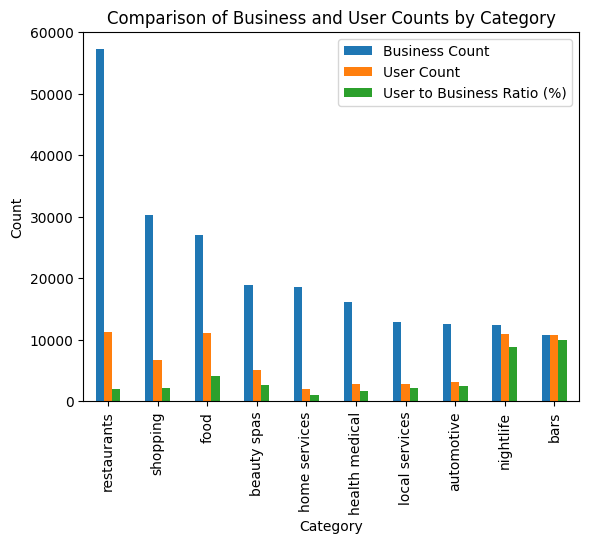

In [237]:
import matplotlib.pyplot as plt
# top_10_bus_result_df['User to Business Ratio (%)'] = top_10_bus_result_df['User to Business Ratio (%)'] / 100

fig, ax = plt.subplots()
top_10_bus_result_df.plot(x='Category', y=['Business Count', 'User Count', 'User to Business Ratio (%)'], kind='bar', ax=ax)
ax.set_title('Comparison of Business and User Counts by Category')
ax.set_xlabel('Category')
ax.set_ylabel('Count')
plt.show()

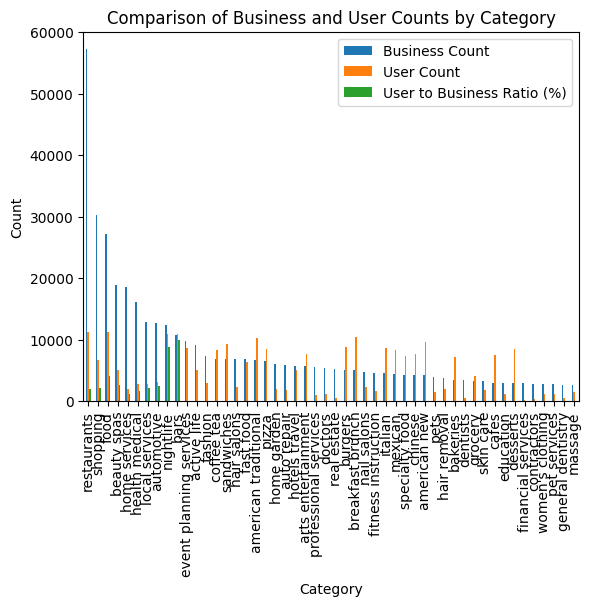

In [255]:
import matplotlib.pyplot as plt
top_50_bus_result_df = analyze_top_business_categories(final_dict, feature_processor.business_df, True, 50)

top_50_bus_result_df['User to Business Ratio'] = top_50_bus_result_df['User Count'] / top_10_bus_result_df['Business Count']
top_50_bus_result_df['User to Business Ratio (%)'] = top_50_bus_result_df['User to Business Ratio'] * 10000

fig, ax = plt.subplots()
top_50_bus_result_df.plot(x='Category', y=['Business Count', 'User Count', 'User to Business Ratio (%)'], kind='bar', ax=ax)
ax.set_title('Comparison of Business and User Counts by Category')
ax.set_xlabel('Category')
ax.set_ylabel('Count')
plt.show()

#### Analyze Top and Bottoom K categories w/ either Bus or User (can be reused)

In [206]:
import pandas as pd

def analyze_top_categories(final_dict, business_df, dimension, total_user=None, reverse=True, top_K=10):
    """
    Find top 10 categories with the most unique entities based on the specified dimension (businesses or users), 
    and calculate their proportions in the business dataset.
    
    Args:
    final_dict (dict): Mapping table with (categories, category_md5) as keys and (business_set, user_set) as values.
    business_df (pd.DataFrame): Processed business dataset with categories and other business-related info.
    dimension (str): The dimension to analyze ("business" or "user").
    
    Returns:
    pd.DataFrame: DataFrame containing the analysis results.
    """
    # Calculate counts for businesses and users per category
    entity_count = {key: len(value[0]) if dimension == "business" else len(value[1]) for key, value in final_dict.items()}
    
    # Sort and get top 10 categories for the specified dimension
    top_categories = sorted(entity_count.items(), key=lambda item: item[1], reverse=reverse)[:top_K]
    
    # Flatten category data and prepare for proportion calculation
    if dimension == "business":
        total_entities = len(business_df['business_id'].unique())
    else:
        # # Correcting the set union operation for user sets
        # all_user_sets = [value[1] for value in final_dict.values()]  # extract all user sets
        # total_entities = len(set.union(*all_user_sets))
        if total_user is None:
            raise ValueError("Total user count must be provided for 'user' dimension analysis.")
        total_entities = total_user
    
    category_list = [item[0][0] for item in top_categories]
    category_set = set(category_list)
    
    # Calculate category proportions
    category_proportions = {}
    for category in category_set:
        if dimension == "business":
            num_entities = business_df['categories'].explode().eq(category).sum()
        else:
            num_entities = entity_count[(category, md5(category.encode('UTF-8')).hexdigest())]
        
        category_proportions[category] = num_entities / total_entities
    
    # Prepare final DataFrame
    result_data = {
        "Category": [cat[0][0] for cat in top_categories],
        f"{dimension.capitalize()} Count": [cat[1] for cat in top_categories],
        "Proportion in Dataset": [category_proportions[cat[0][0]] for cat in top_categories]
    }
    result_df = pd.DataFrame(result_data)
    
    return result_df

In [224]:
total_user = len(feature_processor.user_df)
top_10_bus_result_df = analyze_top_categories(final_dict, feature_processor.business_df, "business", total_user, True, 10)
print(top_10_bus_result_df)

         Category  Business Count  Proportion in Dataset
0     restaurants           57173               0.303155
1        shopping           30231               0.160298
2            food           27118               0.143791
3     beauty spas           18967               0.100571
4   home services           18634               0.098805
5  health medical           16157               0.085671
6  local services           12906               0.068433
7      automotive           12656               0.067107
8       nightlife           12438               0.065952
9            bars           10853               0.057547


# TODO

1. 进一步对市场里的商家分组分簇；
2. 社区检测，不过怎么和第一点才能不冲突？
3. 实现Embedding;

4. 对于现有的features，归一化 (z-score, etc.)，考虑重采样SMOTE等（样本数量不均）；
    - Review Quality: determine the quality of a review I took **the sum of the useful, funny, and cool votes that the review has received.** Looking at the distribution of votes per review you can see that about half of all reviews receive no votes at all. Another sizable portion of reviews receive between 1 and 5 votes. Very few reviews make it over 10 votes.
        - time Discounting, Target Creation - More recent reviews have less time to accumulate votes. This needs to be adjusted for otherwise older reviews will always seem more useful.
        - Feature Engineering - Utilize actual or estimated counts at the time of the review instead of at the time the dataset was released. https://github.com/jeffjohannsen/Predicting_Yelp_Review_Quality
        - Features added include:

            > Sums:
            User Up-votes
            User Compliments

            > Counts:
            User Friends Count
            User Elite Award Count
            Business Check-in Count
            
            > Time Based:
            User Years Since Last Elite Award
            User Days Active at Review Time
            
            >Composites:
            Review Stars vs. User Average
            Review Stars vs. Business Average

5. 分析yelp_true.csv，用户-商家 pair的关系；e.g.是否大部分用户都在评价当地的商家？=》根据地理位置group

# UPDATE: 找到了yelp_engineering的架构，先按照那个版本实现；
1. tip和review 可以合并训练? **review_train的数据太少**
2. 

In [257]:
final_dict[('tours' ,'3c4dce9aea556c3f27b8b1dd2e8987ae')]

({'--o5BoU7qYMALeVDK6mwVg',
  '-1W8v_0LVdvXMtynNcn4aA',
  '-2ToCaDFpTNmmg3QFzxcWg',
  '-CPD0t8h2Acd0r93779sKw',
  '-MH65ETfp3wYNUXgePVZ9w',
  '-MWC_QuOCSOXlJ9G2ohZMA',
  '-MwAxDEDeWxN2Mj9U0Rzww',
  '-Suap0Wo7-lcUXadXsgmOQ',
  '-U5zzQisAz0QHjr_TFIIGQ',
  '-Ucy8i4uc_OzN8y5fkGVaQ',
  '-aEfF30-HyO6qZI909VXFQ',
  '-yZf2fmb6j6B8-GPBghdJg',
  '04__PnXBxnEhgyMv_jYddg',
  '0ADVYK3OwmJATc5bgEHz5w',
  '0I1kpr7be4c8-Ox6kPnRtw',
  '0OZHqFXau4M5-ScGbiPKpA',
  '0PE0mno-0KlOeEqAYOkBXQ',
  '0d1REzQYsfXW2SKJEjAWUw',
  '0eUzjx4qLL-uvYsK5P3iTg',
  '0lDCyIvAWyn-UZDUncDqHA',
  '0uqSkZi4nPAcpf7dKD5McA',
  '0zmewSkB-7NEXC8DkD5sgw',
  '148d7J-cFejkhYV89y3Jsg',
  '1FkUTet5GQ5mVwNLw_Ds4g',
  '1J-IgOUR_VKd9LgJrpoqkg',
  '1RIGI6BHiS9sIv-ddgD1cw',
  '1T6N959Q85RcNol_TuULew',
  '1brdn-zjhKbQlHzmMAFCEg',
  '1udhTLRfcHyQ5eD7Yy4lSg',
  '22dx7VCGStnpaipVOE2Lsw',
  '2JieLs02McAWSFnqVtnDhA',
  '2Qnr8K4Dlozmbc34jl5SWw',
  '2ThtBbeDqFkVi6LugUOcVA',
  '2XviJH7LPHVPUdTd1VZCsg',
  '2h4YvkznuX0ctp2gySJYpw',
  '2jphlrVF801b41EkG

# TODO：用DeepWalk算法进行节点嵌入, 学习节点的向量表示

In [ ]:
# 加载图
G = nx.read_edgelist('../test/GraphEdgeInfo.txt', create_using=nx.DiGraph(), nodetype=str, data=[('weight', int)])

In [ ]:
from gensim.models import Word2Vec
import random

import networkx as nx
import random

def biased_random_walk(G, start, walk_length, alpha=0.1):
    walk = [start]
    while len(walk) < walk_length:
        cur = walk[-1]
        neighbors = list(G.neighbors(cur))
        if not neighbors:
            break
        weights = [G.degree[n]**alpha for n in neighbors]  # 使用节点的度来调整选择概率
        total_weight = sum(weights)
        probabilities = [w / total_weight for w in weights]
        next_node = random.choices(neighbors, weights=probabilities, k=1)[0]
        walk.append(next_node)
    return walk

def generate_walks_focus_high_centrality(G, num_walks, walk_length, central_nodes):
    walks = []
    nodes = list(G.nodes())
    # 将中心节点加入到普通节点列表中增加被选中的机会
    enhanced_node_list = nodes + central_nodes
    for _ in range(num_walks):
        random.shuffle(enhanced_node_list)
        for node in enhanced_node_list:
            walks.append(biased_random_walk(G, node, walk_length))
    return walks


from gensim.models import Word2Vec

def train_word2vec(walks):
    model = Word2Vec(
        walks,
        vector_size=128,  # 嵌入的维度
        window=10,        # Word2Vec中的窗口大小
        min_count=1,      # 最小词频，降低这个值以避免忽略节点
        sg=1,             # 使用skip-gram模型
        workers=12,        # 线程数
        epochs=20         # 增加迭代轮数
    )
    return model



In [14]:
high_pagerank_dict = {'b7f8f342d75c02699b7873f497f4251c': 0.005967296511581442,
 '49cfbe257fc2454107e5b4daf9f83e13': 0.006543823504426392,
 'eef4e33361d1377ab483a3c44cd2dd59': 0.012625949576835662,
 'b3c57d227ea117c0ace12e4538754344': 0.00686299137363107,
 'f2f7141df8592be8740172efb2766054': 0.007714810303538066,
 'babd2925f9a5fe57586bd10374bdecc6': 0.009154904743688892,
 'b2fe440cb7a0b127f1a90ffea296313b': 0.00755275710593123,
 'dfaf4824df9669d973b868f9be7909ff': 0.005266227236035293,
 'b4cdc4d89cbc7c0d18530c968674f7c6': 0.013327093317650335,
 'f57611add43f15fbaa6bd04331da3019': 0.006980318924727074}

In [15]:
high_cent_dict = {'vxR_YV0atFxIxfOnF9uHjQ_uid': 0.011202450032237266,
 'E43QxgV87Ij6KxMCHcijKw_uid': 0.022539222007307114,
 '0BBUmH7Krcax1RZgbH4fSA_uid': 0.012787448957661722,
 'Fv0e9RIV9jw5TX3ctA1WbA_uid': 0.02441972920696325,
 'pMefTWo6gMdx8WhYSA2u3w_uid': 0.014345583494519663,
 'UPIYuRaZvknINOd1w8kqRQ_bid': 0.012760584569095207,
 'UYcmGbelzRa0Q6JqzLoguw_uid': 0.04677090049430475,
 'PKEzKWv_FktMm2mGPjwd0Q_uid': 0.0417203954437997,
 '8AwcaBJjiMpQ__FPxktwwQ_uid': 0.014345583494519663,
 '_VMGbmIeK71rQGwOBWt_Kg_uid': 0.01864388566516226,
 'hTZb1INhnCG8URaFywVoYQ_uid': 0.017461852568235545,
 'N3oNEwh0qgPqPP3Em6wJXw_uid': 0.022619815173006663,
 'm-BZLIIh5PCAKnzH0qj_0Q_uid': 0.014291854717386632,
 'wXZS42D0L8hoCiSh2Krc_A_uid': 0.012035246077799268,
 'cYwJA2A6I12KNkm2rtXd5g_bid': 0.010315925209542231,
 'd5WLqmTMvmL7-RmUDVKqqQ_uid': 0.011121856866537718,
 'JnPIjvC0cmooNDfsa9BmXg_uid': 0.012572533849129593,
 '7Oe6ikklTjVBbEFw9emLcA_uid': 0.017891682785299807,
 'SlgpAnj2gQd44EM_Uq6DkQ_uid': 0.012868042123361272,
 'wd3xoNaDLib8dhQ7BxUl6g_uid': 0.013136686009026434,
 'rNjgVKaBh1PlUA6dYB6EUw_uid': 0.01182033096926714,
 'aD263WOD4RShoqgvVhcKqQ_uid': 0.01955727487642381,
 'kzRq4H_nSf4b3F_sdymWSw_uid': 0.023372018052869117,
 '2EuPAGalYnP7eSxPgFCNDg_uid': 0.01708575112830432,
 'NhgU7RhuYYFmpkb1jlYJ6Q_uid': 0.04440683430045132,
 'BI4jBJVto2tEQ0NiaR0rNQ_uid': 0.015044057597249087,
 'bLbSNkLggFnqwNNzzq-Ijw_uid': 0.05775843541800989,
 'FaHADZARwnY4yvlvpnsfGA_bid': 0.01708575112830432,
 'Q7IoE5m2heQKThuVq3SYFA_uid': 0.011309907586503331,
 'IKSmm5MzHF8cMhMolKaIOw_uid': 0.011068128089404685,
 'xDl9ZF3SckkZde_48W6WeA_uid': 0.013405329894691596,
 '4wp4XI9AxKNqJima-xahlg_uid': 0.027535998280679132,
 'yfxDa8RFOvJPQh0rNtakHA_bid': 0.011363636363636364,
 'Wu0yySWcHQ5tZ_59HNiamg_uid': 0.013566516226090694,
 'I-4KVZ9lqHhk8469X9FvhA_uid': 0.019422952933591232,
 'BGzavA_ddMr-jGmhArv7fg_uid': 0.016118633139909733,
 'JcNSd3dXmIMVHP2CUpvMHA_uid': 0.010772619815173006,
 '48vRThjhuhiSQINQ2KV8Sw_uid': 0.012330754352030947,
 'r_BrIgzYcwo1NAuG9dLbpg_bid': 0.011497958306468945,
 'A5Rkh7UymKm0_Rxm9K2PJw_bid': 0.011336771975069847,
 'ujHiaprwCQ5ewziu0Vi9rw_bid': 0.010208467655276166,
 'U4INQZOPSUaj8hMjLlZ3KA_uid': 0.030410487857296366,
 '0FMte0z-repSVWSJ_BaQTg_uid': 0.02248549323017408,
 'CxDOIDnH8gp9KXzpBHJYXw_uid': 0.046233612722974424,
 'keLUgL_4y60BkppiAsIk8Q_uid': 0.017730496453900707,
 'TibBhm-fbksozIDFD8wjPQ_uid': 0.01673651407693961,
 'XXW_OFaYQkkGOGniujZFHg_bid': 0.011605415860735008,
 'B1829_hxXSEpDPEDJtYeIw_uid': 0.011497958306468945,
 '5wT0vDycEzgq95yVCZ60Aw_uid': 0.013109821620459918,
 'JrXC_MDp38BWwLn2SFdNsA_uid': 0.011014399312271652,
 'xhhE0txKwQtRzgQVVdKkvg_uid': 0.02213625617880937,
 'kmE8w5Y785eZmodsx0V6Ag_uid': 0.013136686009026434,
 'renPzRDqMZpMaHiCD_e1_A_uid': 0.012787448957661722,
 '0o8HUzggoNKay9-ZMj3HqQ_uid': 0.010799484203739523,
 'k4M43lXJuQMpQW65DTqzIQ_uid': 0.013862024500322373,
 'YMgZqBUAddmFErxLtCfK_w_uid': 0.022243713733075435,
 'igHYkXZMLAc9UdV5VnR_AA_bid': 0.011497958306468945,
 '135DbbQnr3BEkQbBzZ9T1A_uid': 0.020873629916183106,
 'fiGqQ7pIGKyZ9G0RqWLMpg_uid': 0.013297872340425532,
 'Xxvz5g67eaCr3emnkY5M6w_uid': 0.014829142488716956,
 'PGeiszoVusiv0wTHVdWklA_uid': 0.014345583494519663,
 'DkYS3arLOhA8si5uUEmHOw_bid': 0.012841177734794755,
 'L8P5OWO1Jh4B2HLa1Fnbng_uid': 0.01018160326670965,
 'fL-b760btOaGa85OJ9ut3w_bid': 0.010396518375241779,
 '7tpZVkiYuMbDP4-NufK2Iw_uid': 0.016199226305609285,
 'C2C0GPKvzWWnP57Os9eQ0w_uid': 0.02425854287556415,
 'RQlnSCjuqMnhR3Qk6j4KoA_uid': 0.022109391790242853,
 'KskYqH1Bi7Z_61pH6Om8pg_bid': 0.012868042123361272,
 'U5YQX_vMl_xQy8EQDqlNQQ_uid': 0.014023210831721469,
 'qlC607Cyp0Mj91vDFvkp3Q_uid': 0.016602192134107026,
 'Kp5KHBSmV-Htc9NeSjJfPA_uid': 0.012357618740597464,
 'HJj82f-csBI7jjgenwqhvw_uid': 0.016897700408338705,
 'S10Q9h_W-MKyog8IdcCNCQ_uid': 0.01501719320868257,
 'LNGBEEelQx4zbfWnlc66cw_bid': 0.010127874489576617,
 'HK-TlD0yVA_tpTXZxfzu2w_uid': 0.011793466580700622,
 'wxQCLMnuVYbdtmQCc2ryZg_uid': 0.013002364066193853,
 'fVILhIglx6RNOXQba5t4kQ_uid': 0.012706855791962174,
 'xEbCNG-3GTw-OxFusnVP9g_uid': 0.01958413926499033,
 'g8OnV26ywJlZpezdBnOWUQ_bid': 0.012787448957661722,
 'Kj9cFO70zZOQorN0mgeLWA_uid': 0.012760584569095207,
 'PSI7wvuqEhhV9Jh_fP2eZQ_uid': 0.011632280249301526,
 's2o_JsABvrZVm_T03qrBUw_uid': 0.012062110466365785,
 'CQ67NJigSe5-uBDX3b_CUw_uid': 0.01480227810015044,
 'EiP1OFgs-XGcKZux0OKWIA_uid': 0.012841177734794755,
 'L8cvMZLWmM4qWTl9SkxJ8g_uid': 0.011363636363636364,
 'OLn8EvPsu4hNug8V5PF2jA_uid': 0.016548463356973995,
 'n86B7IkbU20AkxlFX_5aew_uid': 0.026273372018052868,
 '5CgjjDAic2-FAvCtiHpytA_uid': 0.0110949924779712,
 'rt3PC7WCgCKsoufmQJELfw_uid': 0.01950354609929078,
 'vwLV4TkRMoghs86tB1Ke8Q_uid': 0.010477111540941327,
 'JYcCYNWs8Ul6ewG5kCYW4Q_uid': 0.01281431334622824,
 'GWs9J6lIUqrySTxl6uXO0A_uid': 0.014211261551687083,
 'YvzoOqfBProz9SveFwJYOw_uid': 0.012679991403395659,
 '3nDUQBjKyVor5wV0reJChg_uid': 0.03715344938749194,
 '0tvCcnfJnSs55iB6mqPk3w_uid': 0.02049752847625188,
 'FIk4lQQu1eTe2EpzQ4xhBA_uid': 0.012599398237696109,
 'Ry1O_KXZHGRI8g5zBR3IcQ_uid': 0.015473887814313346,
 'gwIqbXEXijQNgdESVc07hg_uid': 0.013082957231893401,
 'Nhk0jTP2gkU12G4LHJVR3A_uid': 0.010611433483773908,
 '3gRfkaVcEWri-Ju7OQX7uQ_uid': 0.020524392864818396,
 '5LNZ67Yw9RD6nf4_UhXOjw_bid': 0.011148721255104233,
 'eoHdUeQDNgQ6WYEnP2aiRw_bid': 0.011444229529335912,
 '4JNXUYY8wbaaDmk3BPzlWw_bid': 0.019315495379325167,
 'AvC5XQAElcGAAn_Wr5auEg_uid': 0.01778422523103374,
 'iCQpiavjjPzJ5_3gPD5Ebg_bid': 0.014345583494519663,
 'ic-tyi1jElL_umxZVh8KNA_uid': 0.012679991403395659,
 'w-w-k-QXosIKQ8HQVwU6IQ_uid': 0.010718891038039973,
 'JaqcCU3nxReTW2cBLHounA_uid': 0.010047281323877067,
 'yT_QCcnq-QGipWWuzIpvtw_uid': 0.013002364066193853,
 'FREeRQtjdJU83AFtdETBBw_uid': 0.010611433483773908,
 'JesJ-LaNfr3pKhL7gWhDrw_uid': 0.018267784225231034,
 'GGTF7hnQi6D5W77_qiKlqg_uid': 0.020175155813453687,
 'JyxHvtj-syke7m9rbza7mA_bid': 0.010369653986675264,
 'oG9VFtr_ye8v2tDnS3NOYw_uid': 0.01558134536857941,
 'fmzIm7RxEdii5Jz44PtO7g_uid': 0.010342789598108746,
 '3nIuSCZk5f_2WWYMLN7h3w_uid': 0.019664732430689877,
 'tH0uKD-vNwMoEc3Xk3Cbdg_uid': 0.026488287126585,
 '5JVY32_bmTBfIGpCCsnAfw_uid': 0.013136686009026434,
 'hZfzVrhsCQ9JDAb2jYoJNQ_uid': 0.014318719105953148,
 'lQGJcwX105k17081f6pulg_uid': 0.011578551472168493,
 'Ae4uXwFHp-5fGrt6OONaXw_uid': 0.013136686009026434,
 'sa5zd7bwBQzajQB48Y9SUw_uid': 0.011417365140769395,
 'vWP8-aQX0rYJszqkWVL7Ew_uid': 0.018240919836664517,
 'wtNopFY2ybprzk4FuEbWJQ_uid': 0.011793466580700622,
 'C7lXOTSLUAHG3gkG_Q_39w_uid': 0.012411347517730495,
 'iSC96O2NjQc3JExGUHQG0Q_uid': 0.014990328820116054,
 '8fsZcLADFrPTbGrFqMACpg_uid': 0.010020416935310552,
 'vRjVhl3ONG2GfWY4NXJZbQ_uid': 0.020551257253384914,
 'Lfv4hefW1VbvaC2gatTFWA_uid': 0.02084676552761659,
 'RESDUcs7fIiihp38-d6_6g_bid': 0.016924564796905222,
 'TbhyP24zYZqZ2VJZgu1wrg_uid': 0.013405329894691596,
 'TdYKJgSgY2GF_YJnwsi5yQ_uid': 0.018348377390930582,
 'j6wLUT0ZXi-x0otelYIFpA_uid': 0.011121856866537718,
 '8OeTLey-p-WaL9ErNEci1Q_uid': 0.013485923060391146,
 'zBi_JWB5uUdVuz3JLoAxGQ_uid': 0.011766602192134107,
 '3Vd_ATdvvuVVgn_YCpz8fw_uid': 0.012545669460563078,
 'LNPyE5X1K5B_flcTCH9StQ_uid': 0.020954223081882654,
 'Db80SCez0BdYaHdC0xmzoQ_uid': 0.015420159037180314,
 'P7pxQFqr7yBKMMI2J51udw_bid': 0.011309907586503331,
 'y3FcL4bLy0eLlkb0SDPnBQ_uid': 0.02291532344723834,
 '3Qv2rjPXC2eNKyV5lh3J_g_uid': 0.012411347517730495,
 'qewG3X2O4X6JKskxyyqFwQ_uid': 0.04419191919191919,
 'hWDybu_KvYLSdEFzGrniTw_uid': 0.01877820760799484,
 'oIxsWOWytMmV4bf_ffo01w_uid': 0.013109821620459918,
 'BjtJ3VkMOxV2Lan037AFuw_uid': 0.017488716956802063,
 '-xDW3gYiYaoeVASXywTPgw_uid': 0.027240490006447453,
 'YwaKGmRNnSa3R3N4Hf9jLw_uid': 0.01872447883086181,
 'd0D7L-vfQDIADolnPAcb9A_uid': 0.010396518375241779,
 'kl_yCsj4ESbUphmpCfVvRA_uid': 0.0132441435632925,
 'uG35h72BAMutvXAWdRpqCQ_uid': 0.019745325596389425,
 'jlu4CztcSxrKx56ba1a5AQ_uid': 0.014264990328820115,
 'K7lWdNUhCbcnEvI0NhGewg_bid': 0.015769396088545024,
 '9KCoXFS7alSJsGfFsZANFQ_uid': 0.01238448312916398,
 'U0WU9d6gpMNkO_tPXK58Sg_uid': 0.011229314420803781,
 'JUT0U3HTSB3kz9Wh7N0GqA_uid': 0.011497958306468945,
 '9ks-80ZxeCZWNObzEbW4-Q_uid': 0.011444229529335912,
 'Y8adrWFzckrjuC11aAs9Og_uid': 0.010423382763808295,
 'yZpzRSK00hFeLNnwOf8R1g_uid': 0.010020416935310552,
 'eOIMO2wT_WbNqmavhnCRxw_uid': 0.0132441435632925,
 'NjNJ1JLnMlOfnDI6Oz6Qew_uid': 0.010450247152374812,
 'lT49-Xggq_VAB2E9dce0yA_uid': 0.012894906511927788,
 '1dWLN4Mr4hKhu8MQUCKqXQ_uid': 0.014856006877283473,
 '62GNFh5FySkA3MbrQmnqvg_uid': 0.017972275950999355,
 'CDvhiRiczAq0M5pktyiyog_uid': 0.01791854717386632,
 'mb_8jXannipO5T5V5kGXiQ_uid': 0.010450247152374812,
 'D43OWyfzIQjL8feJpYh2SQ_uid': 0.020551257253384914,
 'eEgeuz6Gg12HZkFZTfbb8A_uid': 0.02568235546958951,
 'QJI9OSEn6ujRCtrX06vs1w_uid': 0.023721255104233827,
 'O9pMFJSPg80YVzpMfNikxw_uid': 0.012572533849129593,
 'i_DR3vdE73nVm2GlMbGpGA_uid': 0.038335482484418655,
 'DoRCeCcJbrsM2BiAKj3trA_uid': 0.02149151085321298,
 'Thc2zV-K-KLcvJn3fMPdqQ_uid': 0.014318719105953148,
 'DXh8yxwZCg5Ckj5kmDvKXw_uid': 0.010235332043842681,
 'qPVtjjp8sNQ32p9860SR9Q_uid': 0.01466795615731786,
 'Q9mA60HnY87C1TW5kjAZ6Q_uid': 0.04212336127229744,
 'rCWrxuRC8_pfagpchtHp6A_uid': 0.020255748979153235,
 '1O638BDK_fWuxgTVJwff-A_uid': 0.0172200730711369,
 'ACwBMSJzgW6vOvV7vOrk8Q_uid': 0.01778422523103374,
 'Ryxj0u0AW3mRsRypdYli2A_uid': 0.01294863528906082,
 'NfU0zDaTMEQ4-X9dbQWd9A_uid': 0.02084676552761659,
 'O3q-nwYZykMmacxjru01Zg_uid': 0.011686009026434558,
 'WeVkkF5L39888IPPlRhNpg_uid': 0.04008166774124221,
 'owlUazXSDLaxlOV7z8181g_uid': 0.016333548248441864,
 'LTCxnnAQGaGZPHZx4KbvGA_uid': 0.02304964539007092,
 'P7EV3yrn1PLHDBX6rF6qIg_uid': 0.010047281323877067,
 'uEvusDwoSymbJJ0auR3muQ_uid': 0.014533634214485279,
 '_ir8NHMtV7KPTwmBmlkmQw_uid': 0.011497958306468945,
 'dt9IHwfuZs9D9LOH7gjNew_uid': 0.013459058671824628,
 'Ad-v2Z4vvuzxZxbpywIm0A_uid': 0.012921770900494305,
 'HEvyblFw4I-UsMqgPGYY_Q_uid': 0.01501719320868257,
 'Sv48jgljDP-CRfXmU8uSgA_uid': 0.01216956802063185,
 'oeAhRa8yFa9jtrhaHnOyxQ_uid': 0.010047281323877067,
 'Hi10sGSZNxQH3NLyWSZ1oA_uid': 0.013324736728992048,
 'N044aCKJv3G5WuvwT5AJcA_uid': 0.010933806146572104,
 'A5A34ixb-yy6nwL42iZsnw_uid': 0.026488287126585,
 'rKkpHJkJ27xOwnhy_bMkvA_uid': 0.0132441435632925,
 'q9jCDNZDRUYl2Pwlgxocig_uid': 0.010880077369439071,
 'pxzs-Dy2hXTis-PuNCV37Q_uid': 0.011444229529335912,
 '2weQS-RnoOBhb1KsHKyoSQ_bid': 0.010826348592306039,
 '5I6-yegWr4p1mtUMwNkVtg_uid': 0.011283043197936814,
 'Wc5L6iuvSNF5WGBlqIO8nw_uid': 0.019019987105093488,
 'eSlOI3GhroEtcbaD_nFXJQ_uid': 0.012277025574897914,
 'F_5_UNX-wrAFCXuAkBZRDw_uid': 0.01708575112830432,
 '6H4Zj-c7FqM9mCsXvwaEQw_uid': 0.013217279174725982,
 '8DEyKVyplnOcSKx39vatbg_uid': 0.053809370298732,
 'eZZyuJDouIg4p-GYB3PV_A_uid': 0.015769396088545024,
 'keBv05MsMFBd0Hu98vXThQ_uid': 0.010047281323877067,
 'ZIOCmdFaMIF56FR-nWr_2A_uid': 0.014533634214485279,
 'Bsbumyr3Of8BauN2URK4bg_uid': 0.012035246077799268,
 'eRDWzHCldd6YXypRECvHYg_uid': 0.01584998925424457,
 'QCtHk02W_Asu2LFfdmGQDA_uid': 0.022028798624543305,
 '7sPNbCx7vGAaH7SbNPZ6oA_bid': 0.01515151515151515,
 'U-nR7ND8CDN2x8ia73CH2Q_uid': 0.014856006877283473,
 '8HCEPF0IflyB690Q745fKg_uid': 0.010933806146572104,
 'zpwWpno3U-oZaG3AJuKqSQ_uid': 0.015608209757145927,
 '1vMmzy_K5sdoK9P-mNFJXA_uid': 0.01117558564367075,
 'wnO99pBbGqwqOoTQM25iCw_uid': 0.017945411562432838,
 'PomQayG1WhMxeSl1zohAUA_uid': 0.01359338061465721,
 'DeVGAiOf2mHVUDfxvuhVlQ_uid': 0.010208467655276166,
 '-NbeVN5tnwdyYAvdNkKMjw_uid': 0.011551687083601977,
 'deL6e_z9xqZTIODKqnvRXQ_uid': 0.02904040404040404,
 'V4TPbscN8JsFbEFiwOVBKw_uid': 0.011874059746400172,
 '6tbXpUIU6upoeqWNDo9k_A_uid': 0.01139050075220288,
 'cJh4F1zFNJb2wXCNT1uNWQ_uid': 0.011336771975069847,
 'YTDM5iqsTFIyi1oUBhE1aA_uid': 0.0101010101010101,
 'OXSJCjKtvZPf-YPDCXcWZg_uid': 0.011148721255104233,
 'zgV0ZroIF956gw4cul8MHA_uid': 0.015447023425746829,
 'zFYs8gSUYDvXkb6O7YkRkw_uid': 0.011309907586503331,
 'XLNaiWF21OsAf0fMV6kuSg_uid': 0.014990328820116054,
 'u3ZPMVVEzneq8x856WksJQ_uid': 0.016924564796905222,
 'qUL3CdRRF1vedNvaq06rIA_uid': 0.014560498603051794,
 'JktkPizuRAA32z-m1UCsBw_uid': 0.011739737803567591,
 '_1UbhUyIKUxBV3pKwPCB9Q_uid': 0.01587685364281109,
 'YfYas8wdkrrvbqXcBH9x9w_uid': 0.010396518375241779,
 'aDYNz8cujkDdmbiOh95ANA_uid': 0.010423382763808295,
 'XXKjsdglgwSs9kWtK6ZWUQ_uid': 0.011229314420803781,
 'dGUOe2TBchiGvU1BNkmTog_uid': 0.010342789598108746,
 'hg71CGHy9bwpgY8cGVVg4w_uid': 0.012545669460563078,
 'A1yK1QyPaahfwp38zqn2Bg_uid': 0.01018160326670965,
 'z8wN6EQuw_JF-zTjcNgsLw_uid': 0.024930152589727056,
 'kbB1FfCf1NsJN-PZAQ0xwQ_uid': 0.018563292499462713,
 'ugNQV0isqQSAuuGzoK87sQ_uid': 0.011068128089404685,
 'ZWD8UH1T7QXQr0Eq-mcWYg_uid': 0.01679024285407264,
 '6Ki3bAL0wx9ymbdJqbSWMA_uid': 0.010853212980872554,
 'u_wqt9RshdZsoj8ikLqoEQ_uid': 0.01848269933376316,
 'WaAOt_eG0_-yLpG3fI--3g_uid': 0.012196432409198366,
 'quDu_Z0-i9TCYvdHRnULEw_uid': 0.012894906511927788,
 'bnKo6L4MgcUbLZH7fmnkrA_uid': 0.01380829572318934,
 'o4tYl3Hz0oDfpNn4k02DCw_uid': 0.01281431334622824,
 'T5KBc5QbwZ-Oj9ApE4vZJA_uid': 0.014614227380184827,
 'V7uS5US4oTf-S9u36HJQCQ_uid': 0.010423382763808295,
 'BbwldZQM1i89cAvV7fce3A_uid': 0.01665592091124006,
 '2e5V6M4GNufEnbGJpVdCjw_uid': 0.011686009026434558,
 'syA7uYoDjohc7gWBWaEZmw_uid': 0.010315925209542231,
 'G-6X-llgA_qAxGxocykHzQ_uid': 0.013862024500322373,
 'Rdt-JiAN7Qlw3dJ7UVdNtw_uid': 0.010342789598108746,
 '65yB0ydGXOZ_-T6J_GbKfw_uid': 0.01238448312916398,
 'Ic6-gs1_FjrWGx6JIr95Mw_uid': 0.010262196432409198,
 'eZfHm0qI8A_HfvXScwIYsg_uid': 0.011659144637868041,
 'Dkb-TJFNSWl4PYR8wEcWcw_uid': 0.027724049000644745,
 'fgkJ6KUlrmbKyLDQervxsw_uid': 0.010047281323877067,
 'utjGh0V0XweisHuHM6Wn3Q_uid': 0.012088974854932301,
 'uERlyO-ASZag6XXouCrkhg_uid': 0.014345583494519663,
 'djxnI8Ux8ZYQJhiOQkrRhA_uid': 0.011578551472168493,
 'AyYKTOCL5qM8589oBsqbfA_uid': 0.018455834945196647,
 'y6To06jltp9_C0SHy48sSw_uid': 0.011847195357833655,
 'SfY0jEFqBkrqq9bVi6P31Q_uid': 0.01195465291209972,
 'NRGJ4IvauajqqCbhT640cw_uid': 0.018590156888029227,
 'L6nrDwHJDyV0KThjON-Kog_uid': 0.01066516226090694,
 'gtwM4ijo65AN4DvXdgCu_w_uid': 0.017408123791102514,
 'DYqujEDnSMgwL7sFTRSv8w_uid': 0.01066516226090694,
 'lsZlV02ZdqEzR-qILdT7Cw_uid': 0.012250161186331399,
 'pWEzY3YY0zEAJLlGSSucrQ_uid': 0.010074145712443585,
 'AbMjnKOwg736fcIu8apuyQ_uid': 0.013620245003223726,
 'bzU8Cl6B9nqV1i5NReobvw_uid': 0.0223511712873415,
 'gDy6k3AqlkcN4cEIkWnx_A_uid': 0.0233451536643026,
 'A8TRpa--43-mbig73xfhrA_uid': 0.011202450032237266,
 '0LzxzSM6oqOilJ_Tx8AXzg_uid': 0.01294863528906082,
 'ZcFB7xOpJufgX9hHPFh9mQ_uid': 0.01294863528906082,
 'PhUqhfyk3jdaS0Xb619RJQ_uid': 0.025171932086825704,
 'C3aIEUOx-vrHAeGVDnMAjg_uid': 0.01609176875134322,
 'YttDgOC9AlM4HcAlDsbB2A_uid': 0.023103374167203955,
 'dxzENIwnxH6wnc6zueYnVA_uid': 0.01480227810015044,
 '3e1867f5aee83045775fbe355e6a3ce1': 0.013405329894691596,
 'b7f8f342d75c02699b7873f497f4251c': 0.02568235546958951,
 '694ba3902596c149c44543e5b48b4d8c': 0.10866645175155813,
 'eee6b2aa1bf67d7074c06b49c257cdbb': 0.021598968407479047,
 '49cfbe257fc2454107e5b4daf9f83e13': 0.4213947990543735,
 'ef9f6b385666e3fe4a6f60477a0c7989': 0.01665592091124006,
 '3a3c2d0c9b1f67c2c81b77d5a38ff36b': 0.03793251665592091,
 '62506be34d574da4a0d158a67253ea99': 0.14063507414571244,
 'eef4e33361d1377ab483a3c44cd2dd59': 0.046851493660004295,
 '5f86b388ba4de3c49ad662520829680c': 0.01670964968837309,
 '3dac72783f355eb5f7204a16e28581aa': 0.09988179669030732,
 'b3c57d227ea117c0ace12e4538754344': 0.024930152589727056,
 'a9190f6cd07b85859643e4323600b538': 0.013969482054588436,
 '2b65cd61d1dda6ee966527dd979a6976': 0.011471093917902428,
 'f2f7141df8592be8740172efb2766054': 0.029712013754566946,
 'c2e055acd7ea39b9762acfa672a74136': 0.02084676552761659,
 'cfeffc2540fda42e7cd58bf6a20e9c44': 0.0142381259402536,
 '7442410022a17b13e015c7b9b377d6a1': 0.02162583279604556,
 '7a0dd1fa843fcba29e098122c258dfa1': 0.014076939608854502,
 'babd2925f9a5fe57586bd10374bdecc6': 0.033043197936814955,
 'b2fe440cb7a0b127f1a90ffea296313b': 0.046341070277240486,
 '994fac5e1016aa7b4f2ac02149f04ff8': 0.04591124006017623,
 '3dd1ccb37fd6838a1312ec3e50229100': 0.021384053298946916,
 '8bb7d1c11fcfe87399f2fe8452e1fafe': 0.013217279174725982,
 '7cf2db5ec261a0fa27a502d3196a6f60': 0.03736836449602407,
 '5fc06aea37bbceb54f091f3455215212': 0.020336342144852783,
 '6103120d1f0297588b95b9ed16b90863': 0.019960240704921556,
 '4637f349fd825520680bd20bc1a7ad1f': 0.012357618740597464,
 'a029c3d3081ad4a884c310f3e46d6a09': 0.015635074145712444,
 '130fd2da72540534877fa6874c44d995': 0.011309907586503331,
 '426da1e27f7064c0ae033f127c555637': 0.015285837094347733,
 'c2494875353d814244bb87848b200711': 0.018455834945196647,
 '8175469f5b7510febe85d18daa424a3f': 0.031001504405759724,
 '4e841a41d653890f7473515f7ed989b7': 0.03371480765097786,
 'dfaf4824df9669d973b868f9be7909ff': 0.040941328175370724,
 'b4cdc4d89cbc7c0d18530c968674f7c6': 0.06380292284547603,
 '2267860f043bf39437195f97d46520ea': 0.037529550827423167,
 '0195dffd2c99afdd693bc2e05fd12d8b': 0.033123791102514503,
 '54ccda6d29fed4b41f399682456d715c': 0.042177090049430474,
 '5e87dc4fbb9d713ebc4a7faba03db39d': 0.013485923060391146,
 'dac285f954ce212a9505eb657ca09e59': 0.01958413926499033,
 'a4c1d45db3ece0616e0a380600d3cb35': 0.018617021276595744,
 '2bccd06597f1805b2ffb474654ebcd8a': 0.0465291209972061,
 'e021a4522f2a255e75d772b80eaea158': 0.013056092843326886,
 '2b50b29ca6ea01677c76c5eb82e5ff49': 0.02538684719535783,
 'f57611add43f15fbaa6bd04331da3019': 0.02697184612078229,
 '0e6cd573113af84493e2343c19ea6529': 0.01899312271652697,
 '172576e898f0801a0ed5d42f647235db': 0.013405329894691596,
 'c109add5c87ae89adc4dad2ef4efc9bf': 0.011497958306468945,
 'c38fc61beb1642a2fe33e518dceefd53': 0.011014399312271652,
 '4049cf76aecd83e075d7b9c12d082625': 0.014211261551687083,
 '24902e939ce885f611f60eefb6c7ed68': 0.013539651837524178,
 '1a47293c23b2915cda074a86a8d89515': 0.011229314420803781,
 'ed915b96c219a599299f005f91fcfbac': 0.017112615516870835,
 'eca76eb0e5fe51d074231a71db73effd': 0.02364066193853428,
 '972ae52621668f045e61bd75160131e8': 0.011336771975069847,
 'd09ee90e41c52e21d132c49976439e55': 0.010127874489576617,
 '1aafcfcd9efdd2e7ac43e80ce77bba79': 0.014103803997421019,
 'c8ea971d8c1417bb791caefb5eba4487': 0.020255748979153235,
 '4f4b914d6db35e19101ff003c4e7ea3a': 0.011041263700838168,
 'ab95d57e5f02b0cb5264272e23c974ac': 0.010503975929507844,
 '9d42bc52034504306fc80b80aaa94a7c': 0.010396518375241779,
 '9c45e83763db06038b5f18b8100f6df9': 0.013969482054588436}

In [17]:
# # 增加游走次数和长度
# # 假设中心节点列表中包括一些高度中心性和高PageRank的节点
# central_nodes = list(high_cent_dict.keys())
# central_nodes = list(high_pagerank_dict.keys())

# walks = generate_walks_focus_high_centrality(G, num_walks=30, walk_length=120, central_nodes=central_nodes)

# # train model
# model = train_word2vec(walks)

In [ ]:
import time
start_time = time.time()

from multiprocessing import Pool

def generate_single_walk(args):
    G, start, walk_length = args
    return biased_random_walk(G, start, walk_length)

def parallel_generate_walks(G, num_walks, walk_length, num_workers=10):
    nodes = list(G.nodes())
    args = [(G, node, walk_length) for _ in range(num_walks) for node in nodes]
    with Pool(num_workers) as p:
        walks = p.map(generate_single_walk, args)
    return walks

walks = parallel_generate_walks(G, num_walks=5, walk_length=5)

model = train_word2vec(walks)
# node_embeddings = model.wv

print("Duration: ", time.time() - start_time)

In [19]:
import pandas as pd
from better_XGBoost import process_and_combine_features, rdd_to_pandas
from better_features import FeatureProcessor

df = pd.read_csv("../yelp_combined.csv")

print("DONE")

DONE


In [21]:
import numpy as np

In [22]:
def get_embedding(node_id, embeddings):
    # 根据ID类型选择后缀并获取嵌入向量
    if '_uid' in node_id:
        emb_id = node_id.split('_uid')[0]
    elif '_bid' in node_id:
        emb_id = node_id.split('_bid')[0]
    else:
        emb_id = node_id  # 如果没有后缀，假设ID已经是原始格式
    
    # 尝试从嵌入中获取向量，如果失败则返回零向量
    try:
        return embeddings[emb_id]
    except KeyError:
        return np.zeros(128) 

df['user_embedding'] = df['user_id'].apply(lambda x: get_embedding(x, node_embeddings))
df['business_embedding'] = df['business_id'].apply(lambda x: get_embedding(x, node_embeddings))

In [26]:
# 示例Python代码
def check_nodes_existence(G, node_list):
    return [node for node in node_list if node in G.nodes()]

# 检查示例
missing_users = check_nodes_existence(G, ['SlgpAnj2gQd44EM_Uq6DkQ_uid'])
missing_businesses = check_nodes_existence(G, ['FaHADZARwnY4yvlvpnsfGA_bid'])

print("缺失的用户节点: ", missing_users)
print("缺失的商家节点: ", missing_businesses)

缺失的用户节点:  ['SlgpAnj2gQd44EM_Uq6DkQ_uid']
缺失的商家节点:  ['FaHADZARwnY4yvlvpnsfGA_bid']


In [27]:
def check_node_in_walks(walks, node_id):
    for walk in walks:
        if node_id in walk:
            return True
    return False

# 使用示例
user_in_walks = check_node_in_walks(walks, 'vxR_YV0atFxIxfOnF9uHjQ')
business_in_walks = check_node_in_walks(walks, 'gTw6PENNGl68ZPUpYWP50A')
print(f"用户在游走中: {user_in_walks}, 商家在游走中: {business_in_walks}")


用户在游走中: False, 商家在游走中: False


In [28]:
def check_embeddings(model, node_ids):
    return {node_id: node_id in model.wv for node_id in node_ids}

# 检查示例
embeddings_status = check_embeddings(model, ['vxR_YV0atFxIxfOnF9uHjQ', 'gTw6PENNGl68ZPUpYWP50A'])
print("节点嵌入状态: ", embeddings_status)

节点嵌入状态:  {'vxR_YV0atFxIxfOnF9uHjQ': False, 'gTw6PENNGl68ZPUpYWP50A': False}


In [ ]:
# # 假设 df 是您的原始Yelp评分数据
# # 添加嵌入向量作为特征
# df['user_embedding'] = df['user_id'].apply(lambda x: node_embeddings[x] if x in node_embeddings else np.zeros(128))
# df['business_embedding'] = df['business_id'].apply(lambda x: node_embeddings[x] if x in node_embeddings else np.zeros(128))

# # 准备数据集
# X = np.hstack([np.array(df['user_embedding'].tolist()), np.array(df['business_embedding'].tolist())])  # 这里加入其他特征
# y = df['stars'].values